## Panasonic SOC Prediction - Deep Neural Net (DNN)
Panasonic 18650PF Li-ion Battery Data - https://data.mendeley.com/datasets/wykht8y7tg/1

Kollmeyer, Phillip (2018), “Panasonic 18650PF Li-ion Battery Data”, Mendeley Data, V1, doi: 10.17632/wykht8y7tg.1

In [1]:
import os
import sys
import IPython
import IPython.display
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import collections
from datetime import datetime, timedelta

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

cell_type = "panasonic"
model_type = "dnn_model"
base_path = '../../'

sys.path.append(base_path)
from training import utils

panasonic_data_path = base_path + 'datasets/Panasonic_18650PF'
lg_data_path = base_path + 'datasets/LG_18650HG2'
pre_trained_path = base_path + 'pre-trained/' + cell_type + '_' + model_type

resample_1hz = True
vi_averages = True

2023-03-22 16:38:59.990092: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-22 16:39:03.278482: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-03-22 16:39:03.278547: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-03-22 16:39:03.420789: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-03-22 16:39:12.859092: W tensorflow/stream_executor/platform/de

## Panasonic Test, Train Processing

In [3]:
panasonic_test_temps = ['n10degC', '0degC', '10degC', '25degC']
panasonic_test_discharge_cycles = ['US06', 'LA92', 'NN']

panasonic_train_temps = ['n10degC', '0degC', '10degC', '25degC']
panasonic_train_discharge_cycles = ['UDDS', 'HWFET', 'HWFT']

panasonic_train_files = utils.panasonic_get_files(panasonic_data_path,
                                                  panasonic_train_discharge_cycles, 
                                                  panasonic_train_temps)

panasonic_test_files = utils.panasonic_get_files(panasonic_data_path, 
                                                 panasonic_test_discharge_cycles,
                                                 panasonic_test_temps)

for file in panasonic_train_files:
    if "UDDS_LA92" in file or "LA92_NN" in file:
        panasonic_train_files.remove(file)

for file in panasonic_test_files:
    if "UDDS_LA92" in file or "LA92_NN" in file:
        panasonic_test_files.remove(file)


panasonic_train, panasonic_train_norm = utils.panasonic_create_dataset(panasonic_train_files,
                                                                       panasonic_train_discharge_cycles, 
                                                                       vi_averages, 
                                                                       resample_1hz)

panasonic_test, panasonic_test_norm = utils.panasonic_create_dataset(panasonic_test_files, 
                                                                     panasonic_test_discharge_cycles, 
                                                                     vi_averages, 
                                                                     resample_1hz)

../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-02-17_10.43 0degC_HWFET_Pan18650PF.csv 59854
../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-02-17_17.14 0degC_UDDS_Pan18650PF.csv 128522
../../datasets/Panasonic_18650PF/10degC/Drive Cycles/03-27-17_09.06 10degC_HWFET_Pan18650PF.csv 70406
../../datasets/Panasonic_18650PF/10degC/Drive Cycles/03-27-17_09.06 10degC_UDDS_Pan18650PF.csv 210465
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-20-17_05.56 25degC_HWFTa_Pan18650PF.csv 75955
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-20-17_19.27 25degC_HWFTb_Pan18650PF.csv 75811
../../datasets/Panasonic_18650PF/25degC/Drive cycles/03-21-17_00.29 25degC_UDDS_Pan18650PF.csv 224187
../../datasets/Panasonic_18650PF/n10degC/Drive Cycles/06-07-17_08.39 n10degC_HWFET_Pan18650PF.csv 51385
../../datasets/Panasonic_18650PF/n10degC/Drive Cycles/06-07-17_08.39 n10degC_UDDS_Pan18650PF.csv 109717
../../datasets/Panasonic_18650PF/0degC/Drive cycles/06-01-17_10.36 0degC_LA92_Pan1

## Panasonic Train, Test Stats

In [4]:
panasonic_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,96547.0,3.627809,0.247314,2.498190,3.458090,3.624720,3.815960,4.200710
Current,96547.0,-0.772951,1.119336,-7.437770,-1.506660,-0.620630,-0.071050,5.511660
Temperature,96547.0,12.290873,12.484846,-9.262373,1.796085,11.416263,26.045400,29.822570
Power,96547.0,-2.712749,3.963937,-18.927653,-5.428331,-2.280660,-0.276703,19.280503
Capacity,96547.0,0.481228,0.283894,0.000000,0.238972,0.492247,0.725709,0.968880
Voltage Average,96547.0,3.643568,0.235658,3.021374,3.470979,3.639031,3.828227,4.110933
Current Average,96547.0,-0.793547,0.440024,-1.926452,-1.236214,-0.620933,-0.405029,-0.192152
Power Average,96547.0,-2.798013,1.535319,-5.868891,-4.371582,-2.199998,-1.425870,-0.527066


In [5]:
panasonic_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Voltage,86137.0,3.607147,0.258449,2.492400,3.435570,3.606060,3.797790,4.214870
Current,86137.0,-1.069468,2.368708,-20.484090,-2.044820,-0.278470,-0.000820,9.657050
Temperature,86137.0,13.479079,11.563432,-8.124518,3.494127,12.690260,26.460110,32.770330
Power,86137.0,-3.560242,8.096008,-53.488989,-7.269278,-1.000200,-0.003115,35.042827
Capacity,86137.0,0.464514,0.280495,0.000000,0.221123,0.467619,0.708228,0.963880
Voltage Average,86137.0,3.627756,0.226462,3.038145,3.458828,3.622753,3.802566,4.101948
Current Average,86137.0,-1.106134,0.568743,-2.986729,-1.332306,-0.888142,-0.748530,-0.242808
Power Average,86137.0,-3.706243,1.849461,-9.172898,-4.301810,-2.999961,-2.615629,-0.702527


## Panasonic Dataset Figures, Distribution

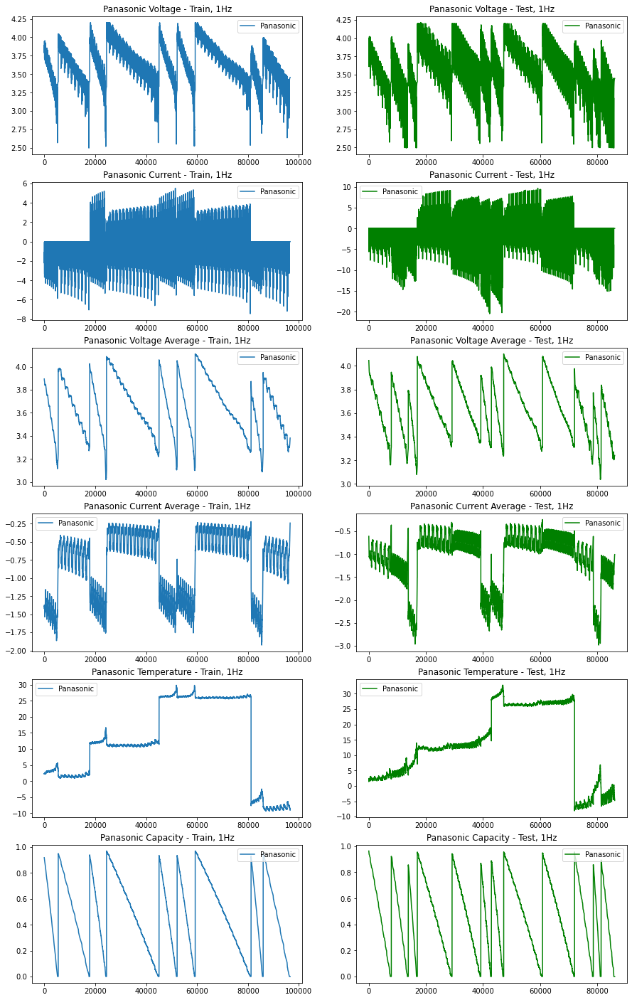

In [6]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(panasonic_train[col], label='Panasonic')
    axs[i, 0].set_title(f'Panasonic {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(panasonic_test[col], label='Panasonic', color="green")
    axs[i, 1].set_title(f'Panasonic {col} - Test, 1Hz')
    axs[i, 1].legend()

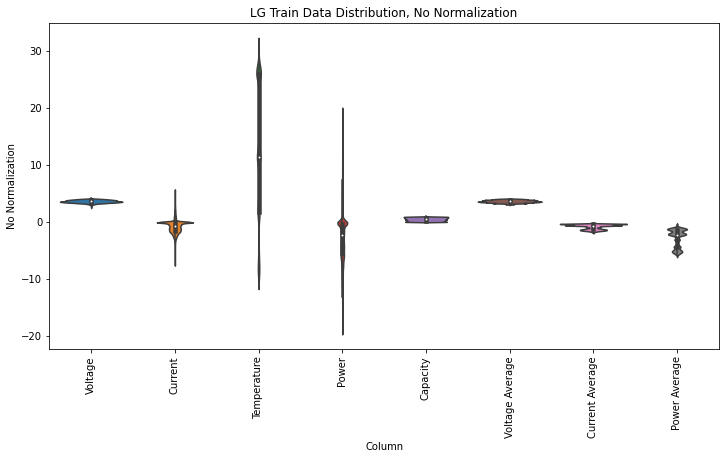

In [7]:
df_std = panasonic_train.melt(var_name='Column', value_name='No Normalization')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='No Normalization', data=df_std)
_ = ax.set_xticklabels(panasonic_train.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, No Normalization')

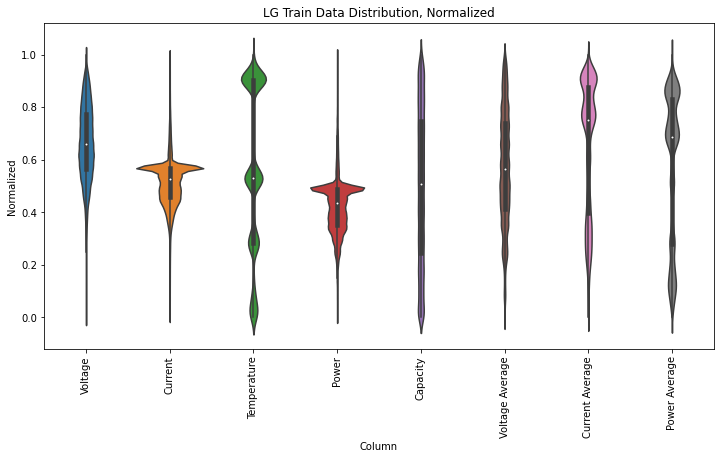

In [8]:
df_std = panasonic_train_norm.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(panasonic_train_norm.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, Normalized')

Text(0.5, 1.01, 'Pair Plot, LG Training Dataset')

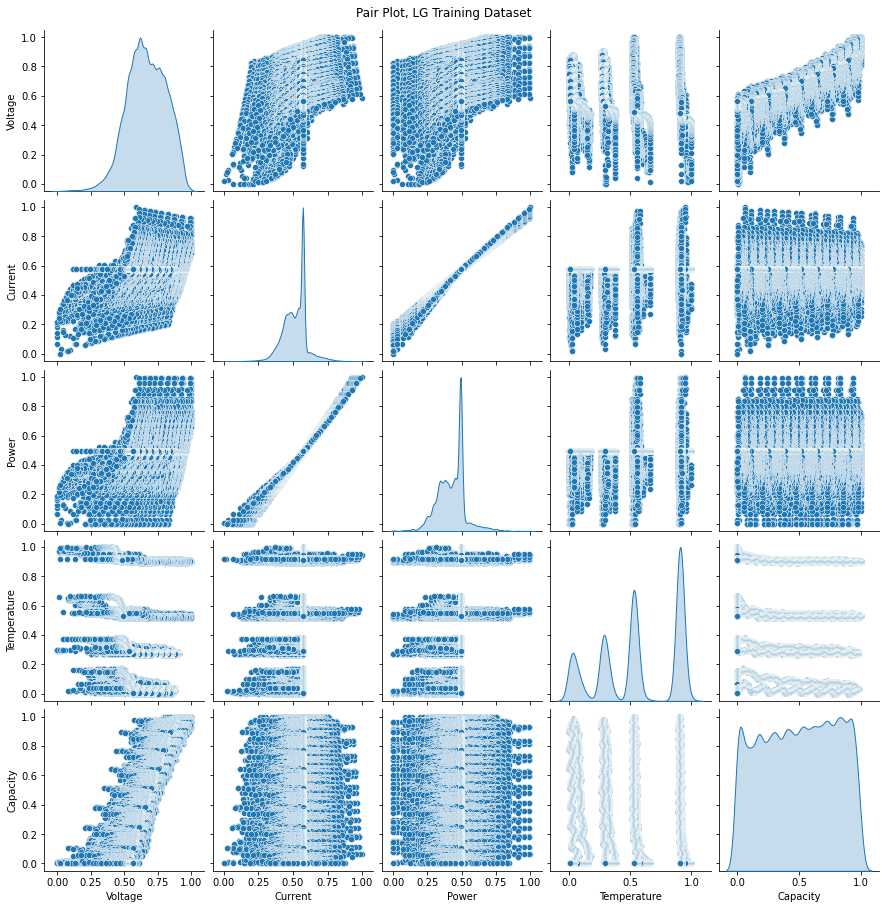

In [9]:
ax = sns.pairplot(panasonic_train_norm[['Voltage', 'Current', 'Power', 'Temperature', 'Capacity']], diag_kind='kde')
ax.fig.suptitle("Pair Plot, LG Training Dataset", y = 1.01) 

## DNN MODEL TRAINING

In [10]:
train_features = panasonic_train_norm[['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']].copy()
test_features = panasonic_test_norm[['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']].copy()

train_labels = train_features.pop('Capacity')
test_labels = test_features.pop('Capacity')

In [12]:
dnn_model = tf.keras.Sequential([
      layers.Dense(256, activation='relu', input_shape=(train_features.shape[1],)),
      layers.Dense(256, activation='relu'),
      layers.Dense(1)
      ])

dnn_model.compile(loss='mean_absolute_error', 
                  optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), metrics=['mse', 'mae', 'mape', tf.keras.metrics.RootMeanSquaredError(name='rmse')])

dnn_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 256)               1536      
                                                                 
 dense_4 (Dense)             (None, 256)               65792     
                                                                 
 dense_5 (Dense)             (None, 1)                 257       
                                                                 
Total params: 67,585
Trainable params: 67,585
Non-trainable params: 0
_________________________________________________________________


In [13]:
%%time
history = dnn_model.fit(
    train_features,
    train_labels,
    validation_split=0.35,
    verbose=1, epochs=25)

Epoch 1/25
1962/1962 [==============================] - 14s 7ms/step - loss: 0.0127 - mse: 8.7316e-04 - mae: 0.0127 - mape: 407464.7500 - rmse: 0.0295 - val_loss: 0.0219 - val_mse: 8.6246e-04 - val_mae: 0.0219 - val_mape: 812190.9375 - val_rmse: 0.0294
Epoch 2/25
1962/1962 [==============================] - 14s 7ms/step - loss: 0.0064 - mse: 6.7251e-05 - mae: 0.0064 - mape: 155512.0625 - rmse: 0.0082 - val_loss: 0.0227 - val_mse: 8.3520e-04 - val_mae: 0.0227 - val_mape: 610628.3125 - val_rmse: 0.0289
Epoch 3/25
1962/1962 [==============================] - 14s 7ms/step - loss: 0.0058 - mse: 5.5516e-05 - mae: 0.0058 - mape: 139221.2656 - rmse: 0.0075 - val_loss: 0.0220 - val_mse: 7.6819e-04 - val_mae: 0.0220 - val_mape: 598389.8750 - val_rmse: 0.0277
Epoch 4/25
1962/1962 [==============================] - 14s 7ms/step - loss: 0.0056 - mse: 5.0574e-05 - mae: 0.0056 - mape: 121628.5703 - rmse: 0.0071 - val_loss: 0.0187 - val_mse: 6.3123e-04 - val_mae: 0.0187 - val_mape: 586453.6875 - val_r

## SAVE MODEL, EVALUATE

In [14]:
dnn_model.save(pre_trained_path)

# load pre-trained model
# model = tf.keras.models.load_model(pre_trained_path)

INFO:tensorflow:Assets written to: ../../pre-trained/panasonic_dnn_model/assets


In [15]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,mse,mae,mape,rmse,val_loss,val_mse,val_mae,val_mape,val_rmse,epoch
20,0.003900,0.000025,0.003900,70101.000000,0.005026,0.013857,0.000335,0.013857,467861.71875,0.018300,20
21,0.003766,0.000024,0.003766,68526.257812,0.004892,0.015935,0.000414,0.015935,441389.59375,0.020351,21
22,0.003712,0.000023,0.003712,65083.503906,0.004789,0.013010,0.000273,0.013010,464995.28125,0.016532,22
23,0.003811,0.000025,0.003811,67738.789062,0.004954,0.013953,0.000346,0.013953,465585.87500,0.018602,23
24,0.003774,0.000024,0.003774,66009.742188,0.004867,0.019891,0.000608,0.019891,366586.46875,0.024658,24


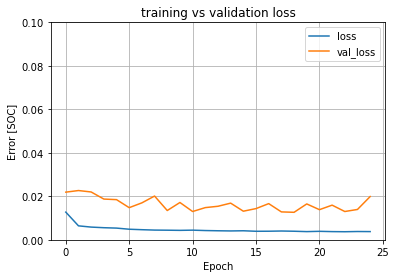

In [16]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.ylim([0, 0.1])
    plt.xlabel('Epoch') 
    plt.ylabel('Error [SOC]')
    plt.title('training vs validation loss')
    plt.legend()
    plt.grid(True)
    
plot_loss(history)

2692/2692 - 7s - loss: 0.0587 - mse: 0.0056 - mae: 0.0587 - mape: 1470323.8750 - rmse: 0.0748 - 7s/epoch - 3ms/step
2692/2692 [==============================] - 9s 3ms/step


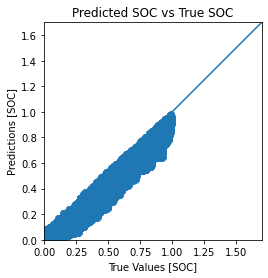

In [17]:
test_results = dnn_model.evaluate(test_features, test_labels, verbose=2)
test_predictions = dnn_model.predict(test_features).flatten()

a = plt.axes(aspect='equal')
plt.scatter(test_labels, test_predictions)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
lims = [0, 1.7]
plt.xlim(lims)
plt.ylim(lims)
plt.title('Predicted SOC vs True SOC')
_ = plt.plot(lims, lims)

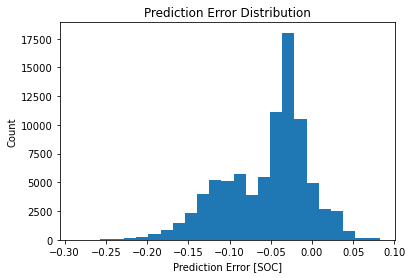

In [18]:
error = test_predictions - test_labels
plt.hist(error, bins=25)
plt.xlabel('Prediction Error [SOC]')
plt.title('Prediction Error Distribution')
_ = plt.ylabel('Count')

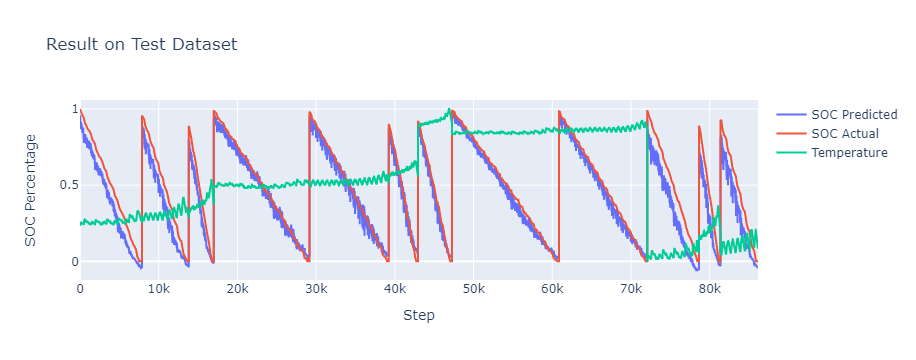

In [19]:
import plotly.graph_objects as go

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num*steps_num, (cycle_num+1)*steps_num)

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index, y=test_predictions[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index, y=test_labels[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index, y=panasonic_test_norm['Temperature'][cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='Temperature'))
fig.update_layout(title='Result on Test Dataset',
                  xaxis_title='Step',
                  yaxis_title='SOC Percentage')
fig.show()